## Class Questions and Answers and code is below

#Q1 Resizing

Shrinking an image makes processing faster and uses less memory,but lose details.


If shrink much crowded street scene too much,might lose small but important objects like people walking on street, traffic signals, or distant vehicles.

 Tiny people or objects could disappear entirely, making it impossible for a detection system to spot them.

# Q2 GrayScaling

Grayscaling can hurt performance when the task relies heavily on colorsrather than shapes or textures. Iff remove color,lose that key information.

forexample, in traffic light detection,physical shape of llight stays the same, but the actual meaning comes from its color red, yellow, green. If grayscale it, all three look almost identical, and the model cant see the difference.

Another examplee is fruit ripeness detection of  ripe banana or tomato is mainly distinguished by its color change. Converting to grayscale would cause problem.

# Q3 Blurring

Blurring is a trade-off that is lossing detail but reduce noise.

Example :In a license plate recognition system, a light blur can smooth out sensor noise, rain droplets, or motion noise from the camera. This can make the edges cleaner and easier for the recognition model to detect.

Disadv:If blur too much,it start removing fine details of the numbers and letters on the plate. The shapes get mix together, making some digits like 8 ,0,3 look same and impossible to distinguish.

In [4]:
import cv2
import numpy as np
import urllib.request
import os
import sys
from google.colab.patches import cv2_imshow

def download_yolo_files():

    urls = {
        'yolov3.weights': 'https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov3.weights',
        'yolov3.cfg': 'https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg',
        'coco.names': 'https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names'
    }
    os.makedirs('yolo_files', exist_ok=True)

    for filename, url in urls.items():
        filepath = os.path.join('yolo_files', filename)
        if not os.path.exists(filepath):
            print(f"Downloading {filename}...")
            try:
                urllib.request.urlretrieve(url, filepath)
                print(f"{filename} downloaded successfully")
            except Exception as e:
                print(f"Failed to download {filename}: {e}")
                print(f"Download manually from: {url}")
                sys.exit(1)
        else:
            print(f"{filename} already exists")

    return 'yolo_files'

def load_yolo_model(model_path):

    classes_file = os.path.join(model_path, 'coco.names')
    with open(classes_file, 'r') as f:
        classes = [line.strip() for line in f.readlines()]

    config_path = os.path.join(model_path, 'yolov3.cfg')
    weights_path = os.path.join(model_path, 'yolov3.weights')

    print("Loading YOLOv3 model...")
    net = cv2.dnn.readNet(config_path, weights_path)
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
    print(f"Model loaded with {len(classes)} classes")

    return net, classes, output_layers

def preprocess_image(image_path, target_size=(416, 416)):
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Could not read image from {image_path}")

    height, width = image.shape[:2]
    blob = cv2.dnn.blobFromImage(image, 1/255.0, target_size, swapRB=True, crop=False)

    return image, blob, (width, height)

def detect_objects(net, blob, output_layers, conf_threshold=0.5):

    net.setInput(blob)
    outputs = net.forward(output_layers)

    boxes, confidences, class_ids = [], [], []
    for output in outputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > conf_threshold:
                center_x, center_y, w, h = detection[:4]
                boxes.append([center_x, center_y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    return boxes, confidences, class_ids

def apply_nms(boxes, confidences, class_ids, width, height, conf_threshold=0.5, nms_threshold=0.4):

    pixel_boxes = []
    for box in boxes:
        cx, cy, w, h = box
        cx = int(cx * width)
        cy = int(cy * height)
        w = int(w * width)
        h = int(h * height)
        x = int(cx - w / 2)
        y = int(cy - h / 2)
        pixel_boxes.append([x, y, w, h])

    if len(pixel_boxes) == 0:
        return [], [], []

    indices = cv2.dnn.NMSBoxes(pixel_boxes, confidences, conf_threshold, nms_threshold)
    final_boxes, final_confidences, final_class_ids = [], [], []

    if len(indices) > 0:
        for i in indices.flatten():
            final_boxes.append(pixel_boxes[i])
            final_confidences.append(confidences[i])
            final_class_ids.append(class_ids[i])

    return final_boxes, final_confidences, final_class_ids

def draw_detections(image, boxes, confidences, class_ids, classes):

    np.random.seed(42)
    colors = np.random.randint(0, 255, size=(len(classes), 3), dtype='uint8')

    for i, box in enumerate(boxes):
        x, y, w, h = box
        label = f"{classes[class_ids[i]]}: {confidences[i]:.2f}"
        color = [int(c) for c in colors[class_ids[i]]]

        cv2.rectangle(image, (x, y), (x + w, y + h), color, 2)
        label_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)[0]
        label_y = y - 10 if y - 10 > 10 else y + 10
        cv2.rectangle(image, (x, label_y - label_size[1] - 4),
                     (x + label_size[0], label_y + 4), color, -1)
        cv2.putText(image, label, (x, label_y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    return image


yolov3.weights downloaded successfully
yolov3.cfg downloaded successfully
coco.names downloaded successfully
Loading YOLOv3 model...
Model loaded with 80 classes
Loaded image with size: 3024x4032
Starting object detection...
Objects detected before NMS: 35
Objects detected after NMS: 19
Detection result saved at detected_image_result.jpg
Displaying the result:


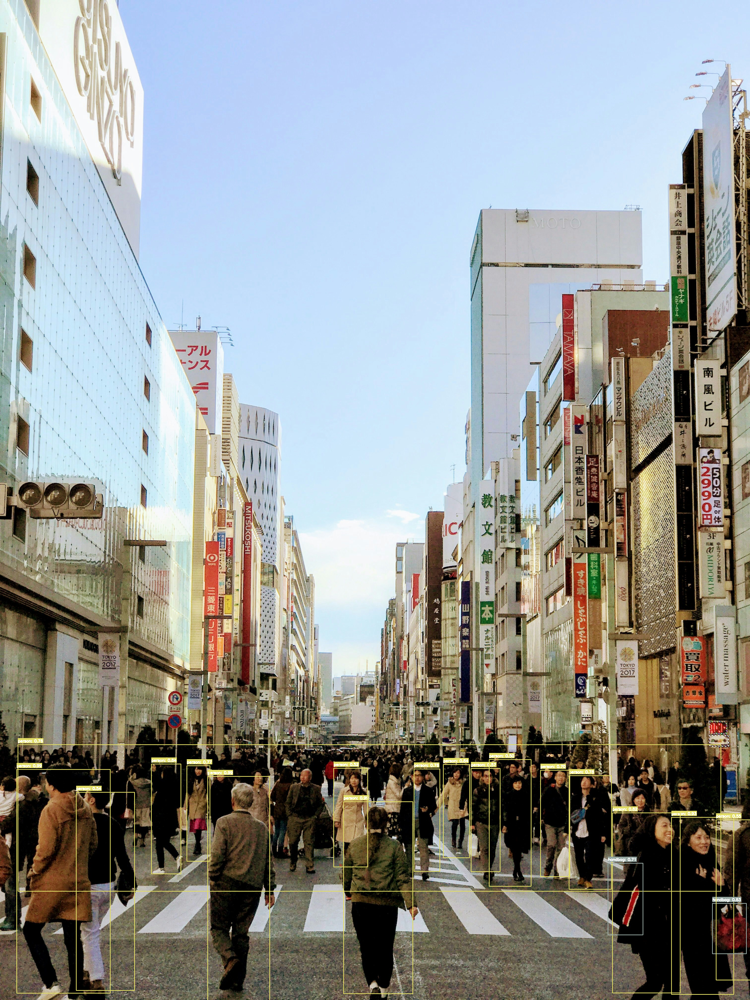


Detection Summary:
- person: 99.19%
- person: 99.17%
- person: 99.13%
- person: 93.40%
- person: 84.07%
- person: 83.92%
- person: 82.36%
- person: 78.36%
- person: 77.28%
- person: 75.77%
- person: 75.70%
- handbag: 70.57%
- person: 70.16%
- handbag: 62.98%
- person: 56.98%
- person: 55.26%
- person: 53.70%
- person: 51.53%
- person: 50.36%


In [5]:

model_path = download_yolo_files()

net, classes, output_layers = load_yolo_model(model_path)

image_path = 'test.jpg'

try:
    image, blob, (width, height) = preprocess_image(image_path)
    print(f"Loaded image with size: {width}x{height}")
except ValueError as e:
    print(f"Error: {e}")
    print("Falling back to sample image...")
    image, blob, (width, height) = preprocess_image('test.jpg')

print("Starting object detection...")
boxes, confidences, class_ids = detect_objects(
    net, blob, output_layers, conf_threshold=0.5
)
print(f"Objects detected before NMS: {len(boxes)}")

final_boxes, final_confidences, final_class_ids = apply_nms(
    boxes, confidences, class_ids, width, height,
    conf_threshold=0.5, nms_threshold=0.4
)
print(f"Objects detected after NMS: {len(final_boxes)}")

result_image = draw_detections(
    image, final_boxes, final_confidences, final_class_ids, classes
)

output_path = 'detected_image_result.jpg'
cv2.imwrite(output_path, result_image)
print(f"Detection result saved at {output_path}")

print("Displaying the result:")
cv2_imshow(result_image)

print("\nDetection Summary:")
for i in range(len(final_boxes)):
    class_name = classes[final_class_ids[i]]
    confidence = final_confidences[i]
    print(f"- {class_name}: {confidence:.2%}")
